# S&P 500 Demo

This tutorial will explain step by step using the historical data from S&P500. Also allows for interactive viewing via plotly.

In [51]:
#Import relevant libraries
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd

import seaborn as sns

%matplotlib inline

import plotly.express as px

import monte_carlo as mc

In [35]:
#Downloading monthly S&P500 data from Yahoo: https://finance.yahoo.com/quote/%5EGSPC/history/
df_SP500 = pd.read_csv('^GSPC.csv')

In [36]:
#Check first 5 rows of dataset. 
df_SP500.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,1927-12-01,17.660000,17.660000,17.660000,17.660000,17.660000,0
1,1928-01-01,17.760000,17.760000,17.260000,17.570000,17.570000,0
2,1928-02-01,17.530001,17.629999,16.950001,17.260000,17.260000,0
3,1928-03-01,17.299999,19.280001,17.299999,19.280001,19.280001,0
4,1928-04-01,18.910000,19.750000,18.910000,19.750000,19.750000,0


In [37]:
#Create new column that calculates % change per month
df_SP500['pct_change'] = (df_SP500['Close'] - df_SP500['Open'])/df_SP500['Open']*100

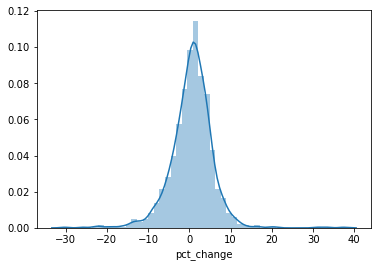

In [38]:
#Plot the historical monthly percent changes for the S&P500 since its inception
sns.distplot(df_SP500['pct_change'], bins=50)

We can see this takes a normal distribution, and thus in our simulation we will also sample via normal distribution.

In [39]:
#Mean and standard deviation of monthly percent changes
avg = df_SP500['pct_change'].mean()
std = df_SP500['pct_change'].std()
print('Mean: ' + str(avg) + ', Standard Deviation: ' + str(std))

Mean: 0.5430624687755805, Standard Deviation: 5.229533685283203


We decide we want to project a 30 year period (= 360 months) and 1000 simulations.  But choose any parameters you'd like. 

In [40]:
#Define length and simulations
num_length = 360 #30 year period. *Note: 360 instead of 30 because our initial time frame was monthly
num_sim = 1000 #run 1000 simulations

Let's say we want to invest $100,000

In [41]:
balance = 100000

In [60]:
#Plug & Chug
df = mc.df_creator(balance, avg, std, num_sim, num_length)

## 1. Creating Interactive Graph of all 1000 simulations

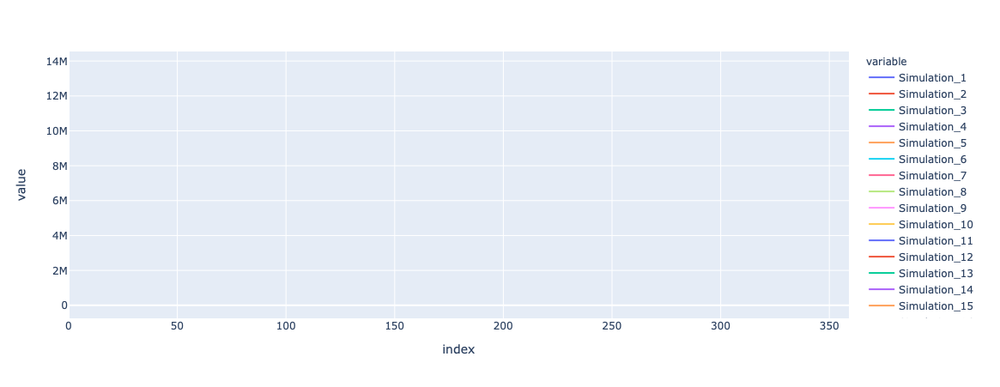

In [61]:
#Interactive line graph using plotly.express
px.line(df)

## 2. Creating distribution plot of final balance

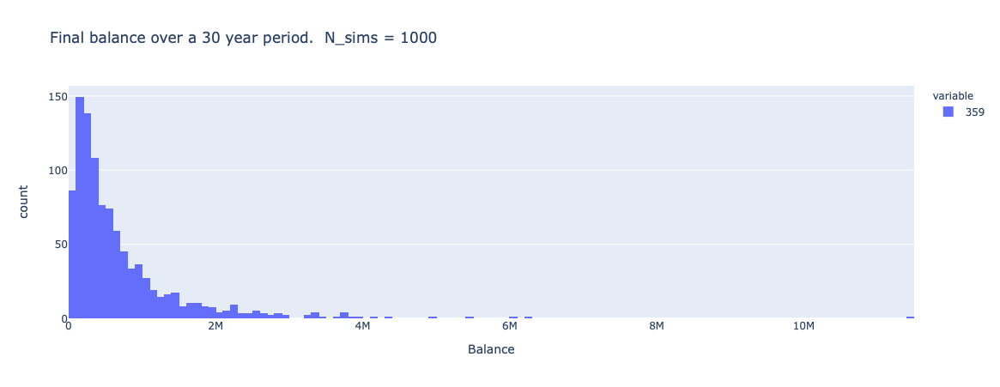

In [63]:
fig = px.histogram(df.iloc[-1], nbins=200, title = "Final balance over a 30 year period.  N_sims = 1000")
fig.update_layout(
    autosize=False,
    xaxis = dict(
        title_text = "Balance"))
fig.show()

We can see the results are heavily skewwed towards the left.  Need to investigate why this happens.  Or a way to penalize this in the future.

In [91]:
#Getting rid of outliers using 3M as our cutoff:
arr = np.array(df.iloc[-1] < 3000000)

In [94]:
df = df.loc[:, arr]

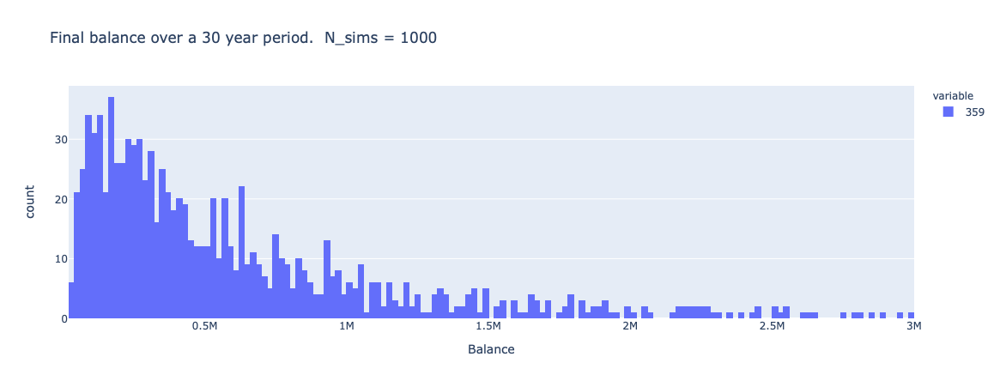

In [95]:
fig = px.histogram(df.iloc[-1], nbins=200, title = "Final balance over a 30 year period.  N_sims = 1000")
fig.update_layout(
    autosize=False,
    xaxis = dict(
        title_text = "Balance"))
fig.show()

Still heavily skewed to the left.  Will investigate this. 

## 3. Reporting Statistics

In [97]:
#Only retrieve the final balances after a 30 year period removing outliers from above. 
df_stats = pd.DataFrame(df.iloc[-1])

In [102]:
#Using the apply function to get rid of scientific notation
df_stats.describe().apply(lambda s: s.apply(lambda x: format(x, 'g')))

,359
count,979
mean,603942
std,567383
min,26405.6
25%,208398
50%,406396
75%,792276
max,2.99367e+06


Conclusion:
- Worst case scenario: $26,406

- Best case scenario: $2,993,670
- Median: 406,396
